<a href="https://colab.research.google.com/github/fabiano152012/Simec/blob/main/Analise_Simec_Obras_0621.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Obras da Educação com recursos do FNDE


In [ ]:
# Instalação pandas-profiling, pycaret e catboost
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
!pip install pycaret
!pip install catboost

In [ ]:
# Importando Bibliotecas
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns 
import plotly as py
from pandas_profiling import ProfileReport

In [ ]:
# Montar o drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## O que é o Simec?
O Sistema Integrado de Monitoramento Execução e Controle do Ministério da Educação (Simec) é um sistema do gestão do MEC, que trata do orçamento e monitoramento das propostas on-line do governo federal na área da educação. Todas as construções e reformas relacionadas à educação com financiamento federal (via  Fundo Nacional de Desenvolvimento da Educação - FNDE) constam do módulo obras do sistema.


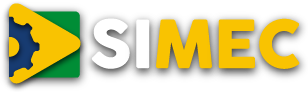

In [ ]:
# Arquivo de dados do Simec
simec = "/content/drive/MyDrive/Dados_Projeto_ESMPU/SIMEC_transparenciadeobras_15-06-2021_090040.csv"

In [ ]:
# Carregando os dados em uma variável
df_simec = pd.read_csv(simec, sep=";", encoding='latin-1', low_memory=False)

In [ ]:
# Mantendo uma cópia dos dados originais
df_original=df_simec

In [ ]:
# Verificando os dados iniciais do dataframe
df_simec.head()

,ID,Nome,Situação,Município,UF,CEP,Logradouro,Bairro,Termo/Convênio,Fim da Vigência Termo/Convênio,Situação do Termo/Convênio,Percentual de Execução,Data Prevista de Conclusão da Obra,Tipo de ensino / Modalidade,Tipo do Projeto,Tipo da Obra,Classificação da Obra,Valor Pactuado pelo FNDE,Rede de Ensino Público,CNPJ,Inscrição Estadual,Nome da Entidade,Razão Social,Email,Sigla,Telefone Comercial,Fax,CEP Entidade,Logradouro Entidade,Complemento Entidade,Número Entidade,Bairro Entidade,UF Entidade,Munícipio Entidade,Modalidade de Licitação,Número da Licitação,Homologação da Licitação,Empresa Contratada,Data de Assinatura do Contrato,Prazo de Vigência,Data de Término do Contrato,Valor do Contrato,Valor Pactuado com o FNDE,Data da Última Vistoria do Estado ou Município,Situação da Vistoria,OBS,Total Pago,Percentual Pago,Banco,Agência,Conta,Data,Saldo da Conta,Saldo Fundos,Saldo da Poupança,Saldo CDB,Saldo TOTAL
0,1365,830167 - Escola de Educação Infantil - Tipo B ...,Concluída,Tauá,CE,63660000,Rua PEDRO INÁCIO DE SOUSA,BEZERRA E SOUSA,830167/2007,NaN,Vigente,100.00,NaN,Educação Básica,Escola de Educação Infantil Tipo B,Construção,Urbana,950000.00,Municipal,7.849532e+12,000000277919,PREF MUN DE TAUA,MUNICIPIO DE TAUA/PREFEITURA MUNICIPAL ...,planejamentotaua@gmail.com,PMT,(88) 34372068 Ramal:,(88) 34372068 Ramal:,63660000.0,Centro Administrativo José Fernandes Castelo -...,NaN,S/N,Planalto dos Colibris,NaN,Tauá,Tomada de Preço,NaN,2008-07-04 00:00:00,(63476931000180) Edmil Eletrificação LTDA,2008-07-04 00:00:00,1030.0,2011-04-30 00:00:00,1003776.02,950000.00,2012-09-24 00:00:00,Concluído,NaN,NaN,NaN,1.0,1155.0,0000327778,2016-06-30 23:59:59,0.0,0.00,0.0,0.0,0.00
1,1366,830361 - Escola de Educação Infantil - Tipo B ...,Concluída,Conchas,SP,18570000,RUA LUIZ SARTORI,JARDIM OLIVEIRA,830361/2007,NaN,Vigente,100.00,NaN,Educação Básica,Escola de Educação Infantil Tipo B,Construção,Urbana,1117078.09,Municipal,4.663412e+13,000000280248,PREF MUN DE CONCHAS,CONCHAS PREFEITURA ...,gabinete@conchas.sp.gov.br,SP,(14) 3845-8011 Ramal:,(14) 3845-8012 Ramal:,18570000.0,RUA MINAS GERAIS,NaN,707,CENTRO,NaN,Conchas,Tomada de Preço,22008,2009-01-12 00:00:00,(61600094000124) KITA CONSTRUTORA LTDA,2009-04-02 00:00:00,758.0,2011-04-30 00:00:00,1117078.09,1117078.09,2011-12-30 00:00:00,Concluído,NaN,NaN,NaN,1.0,1791.0,0000102784,2010-12-31 23:59:59,0.0,107576.07,0.0,0.0,107576.07
2,1367,830053 - Escola de Educação Infantil - Itararé/SP,Concluída,Itararé,SP,18460000,Rua Sofia Dias Menck,Jd. Santa terezinha,830053/2007,NaN,Vigente,100.00,22/08/2014,Educação Básica,Escola de Educação Infantil Tipo B,Construção,Urbana,1024031.00,Municipal,4.663439e+13,000000280359,PREF MUN DE ITARARE,ITARARE PREFEITURA MUNICIPAL ...,gabpref@itarare.sp.gov.br,PMI,(15) 35328000 Ramal:,(15) 35328025 Ramal:,18460000.0,RUA XV DE NOVEMBRO,NaN,83,CENTRO,NaN,Itararé,Convite,082008,2008-12-04 00:00:00,(07336385000101) R. G. CONSTRUCOES ITAPEVA LTDA,2008-12-04 00:00:00,730.0,2010-12-04 00:00:00,1021712.13,1024031.00,2014-08-18 00:00:00,Concluído,NaN,NaN,NaN,1.0,420.0,0000198463,2010-11-30 23:59:59,0.0,7893.77,0.0,0.0,7893.77
3,1368,710101 - Escola de Educação Infantil - Reserva...,Concluída,Reserva do Cabaçal,MT,78265000,Rua princesa izabel,Centro,710101/2008,NaN,Vigente,63.88,02/01/2014,Educação Básica,Escola de Educação Infantil Tipo B,Construção,Urbana,950382.37,Municipal,1.367788e+12,000000282082,PREF MUN DE RESERVA DO CABACAL,RESERVA DO CABACAL PREFEITURA MUNICIPAL ...,prefeiturareserva@gmail.com,PMRC,(65) 32471124 Ramal:,(65) 32471124 Ramal:,78265000.0,AV. MATO GROSSO,NaN,221,CENTRO,NaN,Reserva do Cabaçal,Tomada de Preço,NaN,2012-05-16 00:00:00,(09101297000156) BURITIS COMERCIO E CONSTRUCOE...,2008-12-05 00:00:00,240.0,2009-08-02 00:00:00,947358.10,950382.37,2014-07-22 00:00:00,Paralisado,Contrato Rescindido,NaN,NaN,1.0,2939.0,0000158321,2017-06-30 00:00:00,0.0,0.00,0.0,0.0,0.00
4,1370,700022 - Escola de Educação Inf - São João do ...,Inacabada,São João do Jaguaribe,CE,62965000,Rua 

## Usando Pandas Profiling


In [ ]:
# Analisando os dados com o pandas profiling
profile = ProfileReport(df_simec, title='Dados Simec',html={'style':{'full_width':True}})

In [ ]:
profile

Summarize dataset:   0%|          | 0/70 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Análise Exploratória



*   Colunas desnecessárias para análise inicial

    *Nome - CEP - Logradouro - Bairro - Termo/Convênio - Fim da Vigência Termo/Convênio - Tipo de ensino / Modalidade - CNPJ - Inscrição Estadual - Nome da Entidade - Razão Social - Email - Sigla - Telefone Comercial - Fax - CEP Entidade -  Logradouro Entidade - Complemento Entidade -  Número Entidade - Bairro Entidade -  UF Entidade - Munícipio Entidade - Número da Licitação - Banco - Agência - Conta - Saldo da Conta - Saldo da Poupança - Saldo CDB* 




In [ ]:
# Verificando informação das colunas do dataframe
df_simec.info()

In [ ]:
# Exclusão de colunas desnecessárias para análise
exclui_col0 = ["Nome", "CEP", "Logradouro", "Bairro", "Termo/Convênio", "Fim da Vigência Termo/Convênio", "Tipo de ensino / Modalidade", "CNPJ", "Inscrição Estadual",
              "Nome da Entidade", "Razão Social", "Email", "Sigla", "Telefone Comercial", "Fax", "CEP Entidade", "Logradouro Entidade",
              "Complemento Entidade", "Número Entidade", "Bairro Entidade", "UF Entidade", "Munícipio Entidade", "Número da Licitação", 
              "Banco", "Agência", "Conta", "Saldo da Conta", "Saldo da Poupança", "Saldo CDB"]
df_simec = df_simec.drop(columns= exclui_col0)

In [ ]:
# Criando uma coluna Capital/Interior
capital = ["Rio Branco", "Maceió", "Macapá", "Manaus", "Salvador", "Fortaleza", "Brasília", "Vitória", "Goiânia", "São Luís", "Cuiabá",
           "Campo Grande", "Belo Horizonte", "Belém", "João Pessoa", "Curitiba", "Recife", "Teresina", "Rio de Janeiro", "Natal",
           "Porto Alegre", "Porto Velho", "Boa Vista", "Florianópolis", "São Paulo", "Aracaju", "Palmas"] 
df_simec['capital_interior'] = df_simec['Município']
df_simec['capital_interior'] = df_simec['capital_interior'].replace([capital],"Capital")
df_simec.loc[df_simec.capital_interior != 'Capital', 'capital_interior'] = "Interior"

In [ ]:
# Verificando Capital/interior
df_simec['capital_interior'].value_counts()

Interior    27046
Capital      2453
Name: capital_interior, dtype: int64

In [ ]:
# Criando uma coluna de Região das obras
sul = ["RS", "SC", "PR"]
sudeste = ["SP", "RJ", "ES", "MG"]
nordeste = ["AL", "BA", "CE", "MA", "PB", "PE", "PI", "RN", "SE"]
centro_oeste = ["MT", "MS", "GO", "DF"]
norte = ["AC", "AP", "AM", "PA", "RO", "RR", "TO"]
df_simec['região'] = df_simec['UF']
df_simec['região'] = df_simec['região'].replace([sul],"Sul")
df_simec['região'] = df_simec['região'].replace([nordeste],"Nordeste")
df_simec['região'] = df_simec['região'].replace([sudeste],"Sudeste")
df_simec['região'] = df_simec['região'].replace([centro_oeste],"Centro-oeste")
df_simec['região'] = df_simec['região'].replace([norte],"Norte")

In [ ]:
# Verificando Região
df_simec['região'].value_counts()

Nordeste        12394
Sudeste          5623
Sul              4272
Norte            4235
Centro-oeste     2950
Name: região, dtype: int64

In [ ]:
# Converter os dados strings em data
dados_data = ['Data Prevista de Conclusão da Obra', 'Homologação da Licitação', 'Data de Assinatura do Contrato'
             ,'Data de Término do Contrato', 'Data da Última Vistoria do Estado ou Município', 'Data']
for num in dados_data:
    df_simec[num] = pd.to_datetime (df_simec[num], errors='coerce')

## Dataframe de obras em construção

In [ ]:
# Manter apenas os Tipos de Obra que sejam construção
df_simec2 = df_simec.loc[(df_simec['Tipo da Obra'] == "Construção")]

In [ ]:
# Cria função para definir limite superior de corte
def quartil (dataset, coluna):
    dataset = dataset.dropna(subset=[coluna])
    quartil = dataset[coluna]
    Q1, Q3 = np.percentile(quartil, [25, 75])
    print(f"Primeiro quartil ou percentil 25: {Q1}")
    print(f"Primeiro quartil ou percentil 75: {Q3}")
    Amp_interquartil = Q3 - Q1
    limite_inferior = Q1 - (1.5 * Amp_interquartil)
    global limite_superior
    limite_superior = Q3 + (1.5 * Amp_interquartil)
    print(f"Limite Inferior: {limite_inferior}")
    print(f"Limite Superior: {limite_superior}")
    return 

Primeiro quartil ou percentil 25: 240694.2
Primeiro quartil ou percentil 75: 1183637.29
Limite Inferior: -1173720.4350000003
Limite Superior: 2598051.9250000003


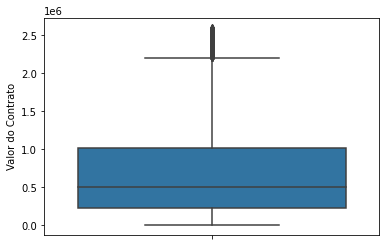

In [ ]:
# Analisar Valores do Contrato (excluir linhas nulas e valores extremos - possíveis erros)
quartil (df_simec2, "Valor do Contrato")
df_simec2 = df_simec2.loc[(df_simec2['Valor do Contrato'] < limite_superior)]
sns.boxplot(y='Valor do Contrato', data=df_simec2)

Primeiro quartil ou percentil 25: 355000.0
Primeiro quartil ou percentil 75: 1100000.0
Limite Inferior: -762500.0
Limite Superior: 2217500.0


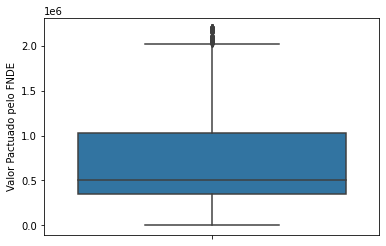

In [ ]:
# Analisar valores de Valor Pactuado pelo FNDE e Valor Pactuado com o FNDE (excluir linhas de valores extremos - possíveis erros)
quartil (df_simec2, "Valor Pactuado pelo FNDE")
df_simec2 = df_simec2.loc[(df_simec2['Valor Pactuado pelo FNDE'] < limite_superior)]
sns.boxplot(y='Valor Pactuado pelo FNDE', data=df_simec2)

In [ ]:
# Excluir missing em Rede de Ensino Público
df_simec2 = df_simec2.dropna(subset=["Rede de Ensino Público"])

Primeiro quartil ou percentil 25: 360.0
Primeiro quartil ou percentil 75: 1073.0
Limite Inferior: -709.5
Limite Superior: 2142.5


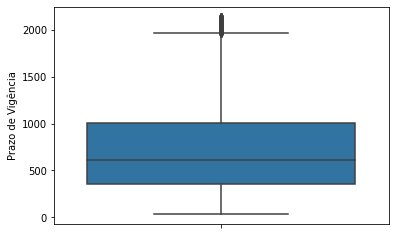

In [ ]:
# Analisar valores de Prazo de vigência (excluir linhas de valores extremos - possíveis erros)
quartil (df_simec2, "Prazo de Vigência")
df_simec2 = df_simec2.loc[(df_simec2['Prazo de Vigência'] < limite_superior)]
sns.boxplot(y='Prazo de Vigência', data=df_simec2)

In [ ]:
# Percentual de dados faltantes por coluna
round(df_simec2.isnull().mean()*100,2)

ID                                                 0.00
Situação                                           0.00
Município                                          0.00
UF                                                 0.00
Situação do Termo/Convênio                         0.00
Percentual de Execução                             0.00
Data Prevista de Conclusão da Obra                12.74
Tipo do Projeto                                    0.00
Tipo da Obra                                       0.00
Classificação da Obra                              0.94
Valor Pactuado pelo FNDE                           0.00
Rede de Ensino Público                             0.00
Modalidade de Licitação                            2.04
Homologação da Licitação                           1.64
Empresa Contratada                                 1.24
Data de Assinatura do Contrato                     0.09
Prazo de Vigência                                  0.00
Data de Término do Contrato                     

## Dataframe de obras concluídas

Para criar um modelo de regressão para estimar o tempo de construção de uma obra serão utilizadas apenas os dados de obras já concluídas.

In [ ]:
# Separar um dataframe com as obras concluídas
df_simec_concluidas = df_simec2.loc[(df_simec['Situação'] == "Concluída")]

In [ ]:
# Excluir as linhas que Situação da Vistoria não esteja como concluídas (possível erro em considerar a obra concluída)
df_simec_concluidas = df_simec_concluidas.loc[(df_simec_concluidas['Situação da Vistoria'] == "Concluído")]

In [ ]:
# Excluir os tipos do projeto MI (Não são mais realizados projetos desse tipo a partir de 2015)
df_simec_concluidas = df_simec_concluidas.loc[(df_simec_concluidas['Tipo do Projeto'] != "MI - Escola de Educação Infantil Tipo B")]
df_simec_concluidas = df_simec_concluidas.loc[(df_simec_concluidas['Tipo do Projeto'] != "MI - Escola de Educação Infantil Tipo C")]

In [ ]:
# Exclui linhas em que o percentual de execução é menor que 90% (possível erro em considerar a obra concluída)
df_simec_concluidas = df_simec_concluidas.loc[(df_simec_concluidas['Percentual de Execução'] > 90)]

In [ ]:
# Verificar se existe Data de Assinatura do Contrato anterior a 2008
df_simec_concluidas["Data de Assinatura do Contrato"].min()

Timestamp('2008-03-11 00:00:00')

In [ ]:
# Verificar se existe Data de Término do Contrato superior a 2022
df_simec_concluidas["Data de Término do Contrato"].max()

Timestamp('2022-02-04 00:00:00')

In [ ]:
# Excluir colunas que não são importantes para o modelo de regressão das obras concluídas
exclui_col = ['ID', 'Município', 'UF', 'Situação', 'Situação do Termo/Convênio',
       'Percentual de Execução', 'Data Prevista de Conclusão da Obra',
       'Valor Pactuado pelo FNDE', "Modalidade de Licitação", "Tipo da Obra",
       'Homologação da Licitação', 'Empresa Contratada', 'Data de Término do Contrato', 
       'Situação da Vistoria', 'OBS', 'Total Pago', 'Percentual Pago', 'Data',
       'Saldo Fundos', 'Saldo TOTAL']
df_simec_concluidas = df_simec_concluidas.drop(columns= exclui_col)

In [ ]:
# Verificando dados das obras concluídas
df_simec_concluidas.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11477 entries, 0 to 29262
Data columns (total 10 columns):
 #   Column                                          Non-Null Count  Dtype         
---  ------                                          --------------  -----         
 0   Tipo do Projeto                                 11477 non-null  object        
 1   Classificação da Obra                           11463 non-null  object        
 2   Rede de Ensino Público                          11477 non-null  object        
 3   Data de Assinatura do Contrato                  11477 non-null  datetime64[ns]
 4   Prazo de Vigência                               11477 non-null  float64       
 5   Valor do Contrato                               11477 non-null  float64       
 6   Valor Pactuado com o FNDE                       11477 non-null  float64       
 7   Data da Última Vistoria do Estado ou Município  11477 non-null  datetime64[ns]
 8   capital_interior                              

In [ ]:
# Verificar linhas com valores nulos
df_simec_concluidas.isnull().sum()

Tipo do Projeto                                    0
Classificação da Obra                             14
Rede de Ensino Público                             0
Data de Assinatura do Contrato                     0
Prazo de Vigência                                  0
Valor do Contrato                                  0
Valor Pactuado com o FNDE                          0
Data da Última Vistoria do Estado ou Município     0
capital_interior                                   0
região                                             0
dtype: int64

In [ ]:
# Apagando registros com valores nulos
df_simec_concluidas = df_simec_concluidas.dropna(subset=["Classificação da Obra"])

In [ ]:
# Criando um "target" de tempo da obra
tempo = abs((df_simec_concluidas ["Data de Assinatura do Contrato"] - df_simec_concluidas ["Data da Última Vistoria do Estado ou Município"]))
df_simec_concluidas.loc[:,'Tempo'] = tempo

In [ ]:
# Convertendo data em número
df_simec_concluidas['Tempo'] = df_simec_concluidas['Tempo'].apply(lambda x: x.total_seconds()/86400).tolist()

In [ ]:
# Tempo de obra incluído e convertido em número
df_simec_concluidas.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11463 entries, 0 to 29122
Data columns (total 11 columns):
 #   Column                                          Non-Null Count  Dtype         
---  ------                                          --------------  -----         
 0   Tipo do Projeto                                 11463 non-null  object        
 1   Classificação da Obra                           11463 non-null  object        
 2   Rede de Ensino Público                          11463 non-null  object        
 3   Data de Assinatura do Contrato                  11463 non-null  datetime64[ns]
 4   Prazo de Vigência                               11463 non-null  float64       
 5   Valor do Contrato                               11463 non-null  float64       
 6   Valor Pactuado com o FNDE                       11463 non-null  float64       
 7   Data da Última Vistoria do Estado ou Município  11463 non-null  datetime64[ns]
 8   capital_interior                              

Primeiro quartil ou percentil 25: 517.0
Primeiro quartil ou percentil 75: 1183.0
Limite Inferior: -482.0
Limite Superior: 2182.0


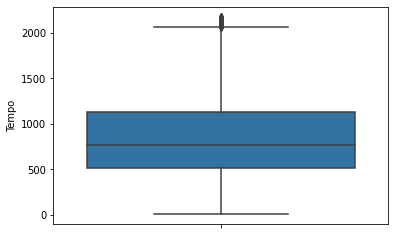

In [ ]:
# Analisar valores de Tempo (excluir linhas de valores extremos - possíveis erros)
quartil (df_simec_concluidas, "Tempo")
df_simec_concluidas = df_simec_concluidas.loc[(df_simec_concluidas['Tempo'] < limite_superior)]
sns.boxplot(y='Tempo', data=df_simec_concluidas)

In [ ]:
# Manter apenas o ano do contrato
df_simec_concluidas['Ano_contrato'] = df_simec_concluidas["Data de Assinatura do Contrato"].dt.year

In [ ]:
# Excluir colunas de datas que não são importantes para regressão das obras concluídas
exclui_col2 = ['Data de Assinatura do Contrato', 'Data da Última Vistoria do Estado ou Município']
df_simec_concluidas = df_simec_concluidas.drop(columns= exclui_col2)

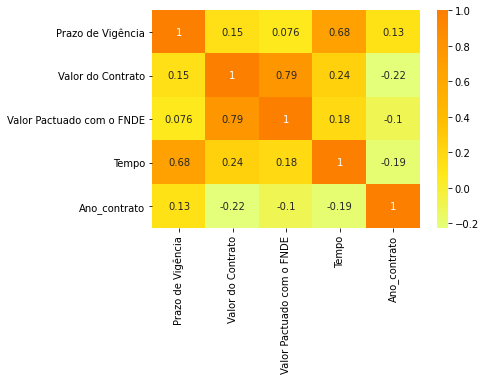

In [ ]:
# Correlação
sns.heatmap(df_simec_concluidas.corr(), annot=True, cmap="Wistia")
plt.show()

## Preparando os dados para usar nos modelos individualmente

In [ ]:
df_simec_concluidas.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11131 entries, 0 to 29122
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Tipo do Projeto            11131 non-null  object 
 1   Classificação da Obra      11131 non-null  object 
 2   Rede de Ensino Público     11131 non-null  object 
 3   Prazo de Vigência          11131 non-null  float64
 4   Valor do Contrato          11131 non-null  float64
 5   Valor Pactuado com o FNDE  11131 non-null  float64
 6   capital_interior           11131 non-null  object 
 7   região                     11131 non-null  object 
 8   Tempo                      11131 non-null  float64
 9   Ano_contrato               11131 non-null  int64  
dtypes: float64(4), int64(1), object(5)
memory usage: 956.6+ KB


In [ ]:
# bibliotecas de preprocessamento e algoritmos
from sklearn.pipeline import Pipeline
from sklearn import metrics
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.model_selection import train_test_split, KFold, cross_validate
from sklearn.linear_model import LinearRegression, Ridge, Lasso, BayesianRidge
from sklearn.compose import ColumnTransformer
from sklearn import svm
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from lightgbm import LGBMRegressor

In [ ]:
# Separando o dataset treino - teste
X = df_simec_concluidas.drop("Tempo", axis=1)
y = df_simec_concluidas["Tempo"]
categorical_variables = ["capital_interior", "região", "Classificação da Obra", "Rede de Ensino Público"]
continuos_variables = ["Prazo de Vigência", "Valor do Contrato", "Valor Pactuado com o FNDE", "Ano_contrato"]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split (X, y, test_size = 0.2, random_state = 2021)

In [ ]:
# Preprocessameno dos dados para o pipeline
preprocessor = ColumnTransformer(transformers=[('OneHot', OneHotEncoder(), categorical_variables),
                                               ('Scaler', StandardScaler(), continuos_variables)])

In [ ]:
# Usando o pipeline em vários regressores para verificar o melhor
regressors = [LinearRegression(fit_intercept=True, normalize=True),
              svm.SVR(gamma='auto'),
              Ridge (normalize = True),
              Lasso (normalize = True, max_iter = 1e5),
              BayesianRidge (),
              KNeighborsRegressor(n_neighbors=31),
              DecisionTreeRegressor(max_depth=7),
              RandomForestRegressor(n_jobs=-1, max_depth=9, n_estimators=140),
              GradientBoostingRegressor(max_depth = 4, n_estimators=160),
              LGBMRegressor(max_depth = 9, n_estimators=50, num_leaves=33)]
            
for regressor in regressors:
    pipeline = Pipeline(steps=[("preprocessor", preprocessor), ("regressor", regressor)])
    pipeline.fit(X_train, y_train)
    kfold = KFold(n_splits=5, shuffle=True, random_state=2021)
    results = cross_validate(pipeline, X_train, y_train, cv=kfold)
    print(f"\n{regressor}")
    print("Score do modelo: %.4f" % pipeline.score(X_test, y_test))
    print("Acurácia média: %f (%f)" %(results['test_score'].mean(), results['test_score'].std()))


LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=True)
Score do modelo: 0.5598
Acurácia média: 0.553270 (0.031079)

SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='auto',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False)
Score do modelo: 0.4661
Acurácia média: 0.411166 (0.029878)

Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None, normalize=True,
      random_state=None, solver='auto', tol=0.001)
Score do modelo: 0.4184
Acurácia média: 0.415736 (0.020523)

Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=100000.0,
      normalize=True, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False)
Score do modelo: 0.4598
Acurácia média: 0.462483 (0.029502)

BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_i

## Usando o Pycaret

In [ ]:
# configuração do pycarte para o colab
from pycaret.utils import enable_colab
enable_colab()

Colab mode enabled.


In [ ]:
# Importando o pycaret para verificar melhor algoritmo de regressão
from pycaret.regression import *

In [ ]:
reg_pyc = setup (data = df_simec_concluidas, target = 'Tempo', train_size = 0.8, session_id = 2021)

,Description,Value
0,session_id,2021
1,Target,Tempo
2,Original Data,"(11131, 10)"
3,Missing Values,False
4,Numeric Features,3
5,Categorical Features,6
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(8904, 52)"


In [ ]:
best = compare_models(fold=5, n_select = 4)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
catboost,CatBoost Regressor,201.8064,85419.8060,292.2490,0.6032,0.3999,0.3552,3.286
gbr,Gradient Boosting Regressor,204.0769,85569.7833,292.5161,0.6024,0.4068,0.3754,0.956
lightgbm,Light Gradient Boosting Machine,203.0419,86007.7660,293.2457,0.6004,0.4017,0.3552,0.244
rf,Random Forest Regressor,208.8371,91674.0578,302.7473,0.5742,0.4092,0.3594,3.812
br,Bayesian Ridge,216.8410,92455.9039,304.0252,0.5703,0.4117,0.3803,0.068
ridge,Ridge Regression,216.8249,92540.4953,304.1642,0.5699,0.4116,0.3796,0.024
lasso,Lasso Regression,217.8150,92799.0531,304.5969,0.5687,0.4149,0.3849,0.052
lr,Linear Regression,217.5803,93105.2625,305.1003,0.5673,0.4135,0.3811,0.286
omp,Orthogonal Matching Pursuit,228.4960,99679.1593,315.6944,0.5368,0.4419,0.4141,0.042
et,Extra Trees Regressor,216.1541,102858.2708,320.6720,0.5223,0.4277,0.3623,3.448


Analisar os 4 algoritmos que apresentaram o melhores R2 e MAE no teste: **Random Forest**, **Light Gradient Boosting Machine**, **Gradient Boost Regressor** e **Catboost**.

In [ ]:
print(best)

[<catboost.core.CatBoostRegressor object at 0x7fa2847190d0>, GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=100,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=2021, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False), LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=100, n_jobs=-1, 

In [ ]:
# Criando o modelo com o Random Forest
pyc_rf = create_model('rf', fold = 10)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,216.3718,100447.3607,316.9343,0.5509,0.4261,0.3625
1,197.2664,82780.1065,287.7153,0.6328,0.3685,0.3016
2,194.3735,77086.9973,277.6455,0.6199,0.4305,0.3981
3,209.8006,95411.2055,308.8870,0.5485,0.4198,0.3476
4,217.2066,100565.0774,317.1200,0.5500,0.4076,0.3538
5,206.7806,88044.5067,296.7229,0.5594,0.3845,0.3170
6,202.6154,84059.4168,289.9300,0.6101,0.3906,0.3237
7,213.0730,96502.8907,310.6491,0.5598,0.4336,0.4977
8,207.0267,94217.1898,306.9482,0.5650,0.3953,0.3106
9,211.2180,88527.5979,297.5359,0.5878,0.4043,0.3358


In [ ]:
# Criando o modelo com o Gradient Boosting Regressor
pyc_gbr = create_model('gbr', fold = 10)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,210.2685,92563.0893,304.2418,0.5861,0.4178,0.3597
1,193.7888,77525.7844,278.4345,0.6561,0.3814,0.3231
2,192.6371,74206.9576,272.4095,0.6341,0.4381,0.4327
3,208.8528,92950.3161,304.8775,0.5602,0.4201,0.3564
4,207.4292,91968.2395,303.2627,0.5885,0.3984,0.3415
5,204.9791,84236.2379,290.2348,0.5784,0.3905,0.3276
6,203.2551,82580.8452,287.3688,0.6169,0.3926,0.3341
7,209.8474,89974.1771,299.9570,0.5896,0.4371,0.5907
8,201.1641,86050.8620,293.3443,0.6027,0.3899,0.3172
9,206.0735,82531.4133,287.2828,0.6157,0.3892,0.3285


In [ ]:
# Criando o modelo com o Light Gradient Boosting Machine
pyc_lightgbm = create_model('lightgbm', fold = 10)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,209.2078,93750.5053,306.1870,0.5808,0.4167,0.3427
1,192.9466,77271.7407,277.9779,0.6573,0.3717,0.3099
2,187.8133,72324.8858,268.9329,0.6433,0.4232,0.4004
3,204.8112,91375.0084,302.2830,0.5676,0.4116,0.3436
4,206.7744,93936.8695,306.4912,0.5797,0.4003,0.3326
5,202.8879,82936.8061,287.9875,0.5849,0.3820,0.3145
6,203.5824,83047.5960,288.1798,0.6148,0.3944,0.3290
7,206.8508,90360.8774,300.6009,0.5878,0.4272,0.5346
8,201.0835,87416.1252,295.6622,0.5964,0.3848,0.3062
9,205.8766,83936.1128,289.7173,0.6092,0.3886,0.3181


In [ ]:
# Criando o modelo com o Catboost
pyc_catboost = create_model('catboost', fold = 10)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,210.3592,93175.2951,305.2463,0.5834,0.4201,0.3517
1,191.9071,77037.3121,277.5560,0.6583,0.3625,0.3010
2,189.7137,73174.9252,270.5086,0.6392,0.4288,0.4154
3,207.5536,93201.0001,305.2884,0.5590,0.4181,0.3566
4,203.2595,91645.0255,302.7293,0.5899,0.3951,0.3283
5,204.5994,83654.1992,289.2304,0.5813,0.3841,0.3154
6,200.9058,81651.1302,285.7466,0.6212,0.3912,0.3251
7,206.0615,89179.4405,298.6293,0.5932,0.4271,0.5317
8,199.2732,87407.6328,295.6478,0.5964,0.3824,0.3002
9,203.5242,84038.0280,289.8931,0.6087,0.3988,0.3094


In [ ]:
# A função blend_models cria vários modelos e, em seguida, calcula a média das previsões individuais para formar a previsão final.
blender = blend_models(estimator_list = [pyc_lightgbm, pyc_rf, pyc_gbr, pyc_catboost])

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,207.6043,91725.4730,302.8621,0.5899,0.4103,0.3480
1,190.0574,75641.6573,275.0303,0.6645,0.3648,0.3033
2,187.0029,70999.6238,266.4575,0.6499,0.4233,0.4056
3,204.0453,90271.2530,300.4517,0.5729,0.4113,0.3462
4,204.7239,91340.3981,302.2257,0.5913,0.3940,0.3342
5,201.4719,81821.7686,286.0450,0.5905,0.3780,0.3136
6,199.0788,80152.8421,283.1128,0.6282,0.3855,0.3228
7,204.4729,88284.2779,297.1267,0.5973,0.4242,0.5326
8,198.3157,85783.9738,292.8890,0.6039,0.3807,0.3028
9,202.2453,81831.8085,286.0626,0.6190,0.3854,0.3170


In [ ]:
#Finalizando o modelo blender criado
final_blender = finalize_model (blender)

In [ ]:
print(final_blender)

VotingRegressor(estimators=[('lightgbm',
                             LGBMRegressor(boosting_type='gbdt',
                                           class_weight=None,
                                           colsample_bytree=1.0,
                                           importance_type='split',
                                           learning_rate=0.1, max_depth=-1,
                                           min_child_samples=20,
                                           min_child_weight=0.001,
                                           min_split_gain=0.0, n_estimators=100,
                                           n_jobs=-1, num_leaves=31,
                                           objective=None, random_state=2021,
                                           reg_alpha=0.0, reg_lambda=0.0,
                                           silent=True, sub...
                                                       min_impurity_split=None,
                                              

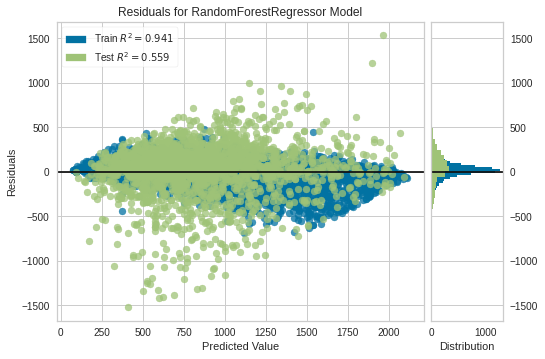

In [ ]:
# Resíduos no Random Forest
plot_model(pyc_rf)

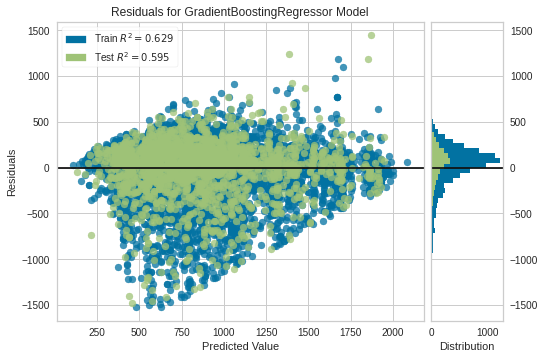

In [ ]:
# Resíduos no Gradiente Boosting Regressor
plot_model(pyc_gbr)

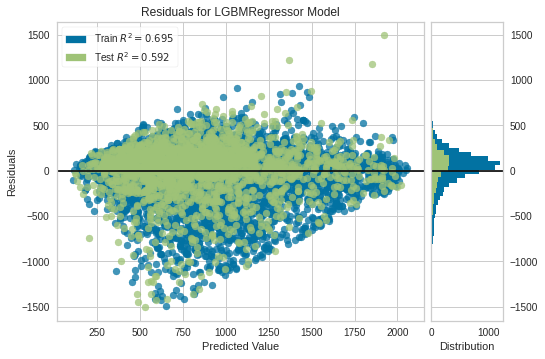

In [ ]:
# Resíduos no Light Gradiente Boosting Machine
plot_model(pyc_lightgbm)

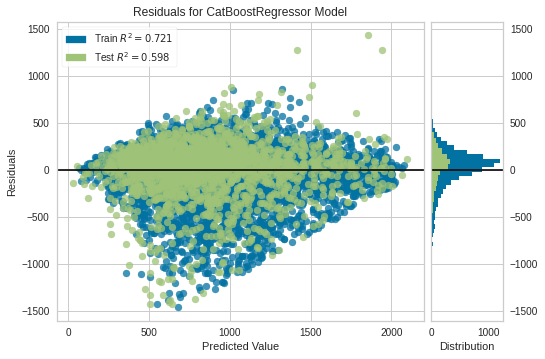

In [ ]:
# Resíduos no Catboost Regressor
plot_model(pyc_catboost)

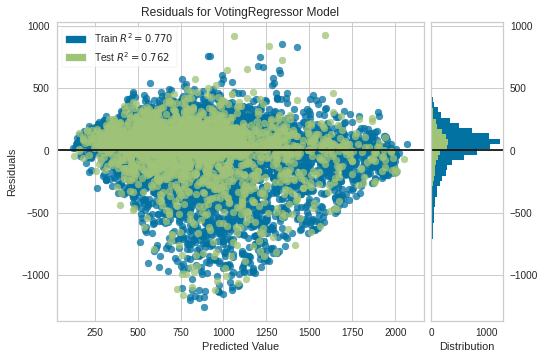

In [ ]:
# Resíduos no blender (ajuste melhor nos dados de testes)
plot_model(final_blender)

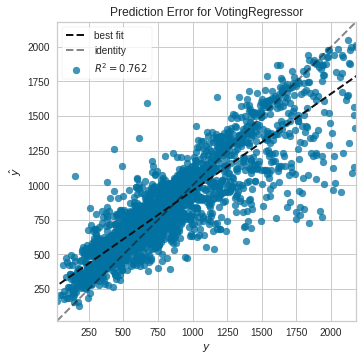

In [ ]:
# Predição de erro no modelo blender
plot_model(final_blender, plot = 'error')

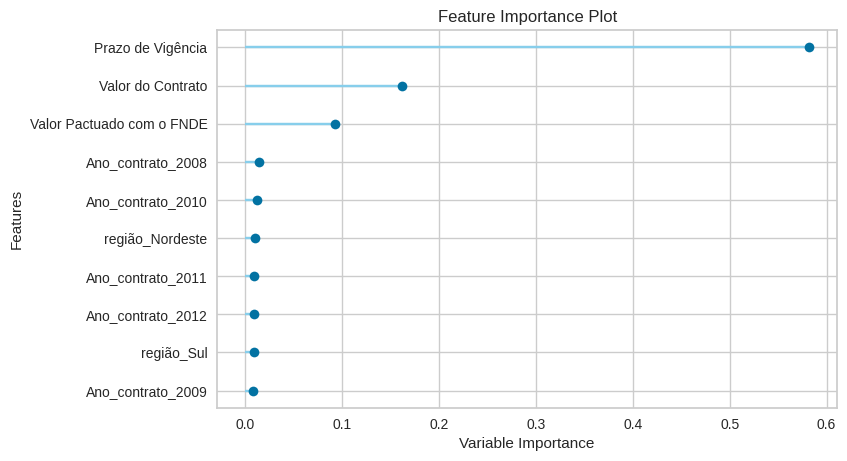

In [ ]:
# importãncia das colunas usadas pelo algoritmo Random Forest
plot_model(pyc_rf, plot='feature')

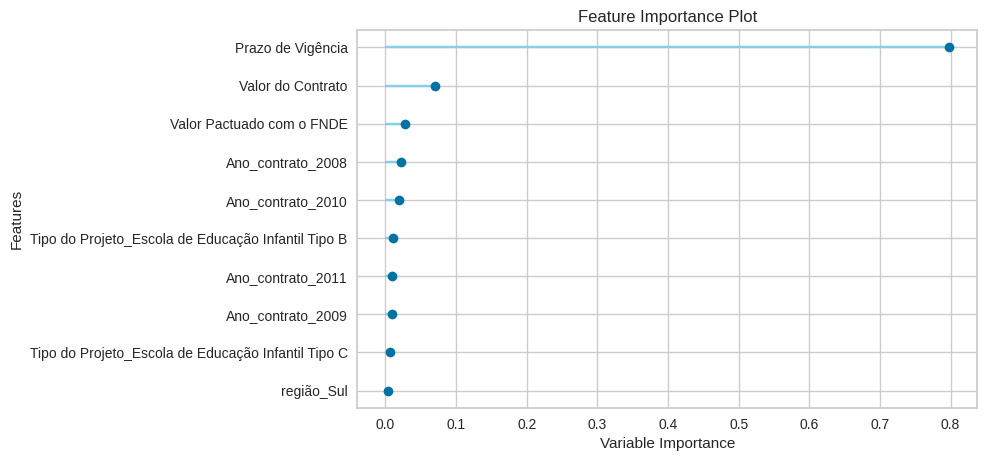

In [ ]:
# importãncia das colunas usadas pelo algoritmo Gradiente Boosting Regressor
plot_model(pyc_gbr, plot='feature')

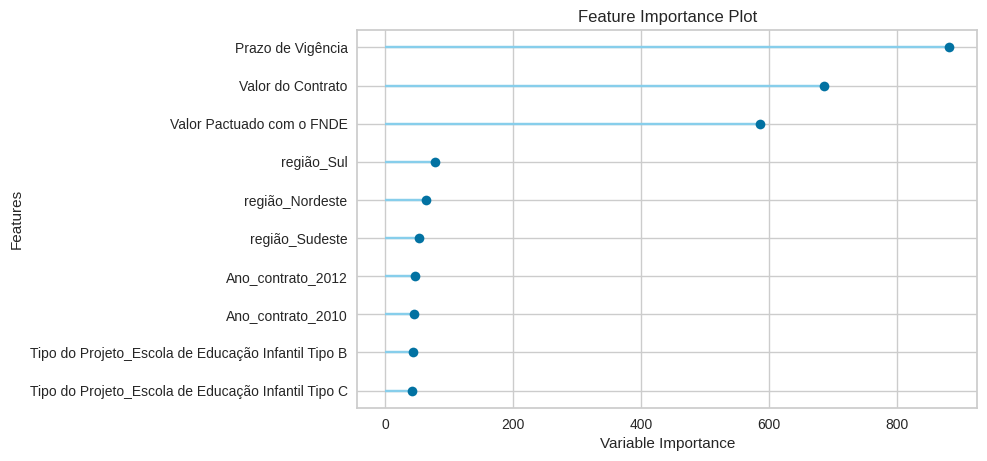

In [ ]:
# importância das colunas usadas pelo algoritmo Light Gradiente Boosting Machine
plot_model(pyc_lightgbm, plot='feature')

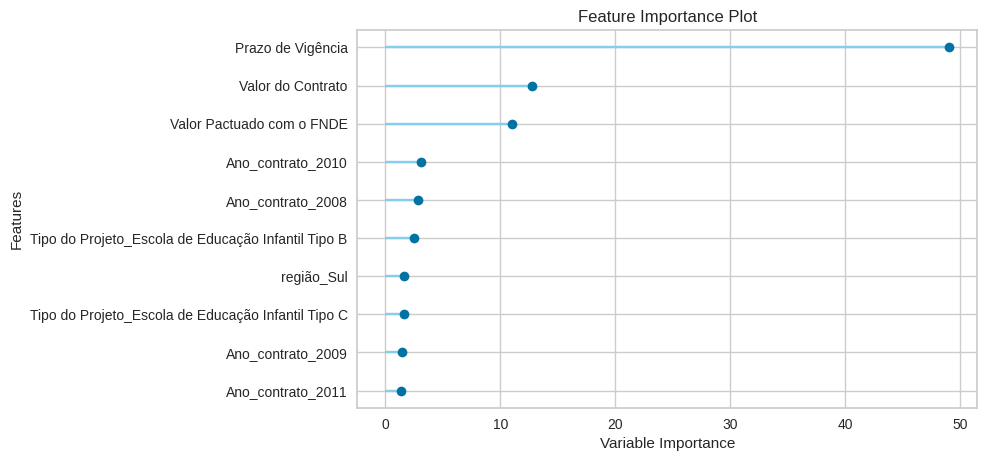

In [ ]:
# importãncia das colunas usadas pelo algoritmo Catboost Regressor
plot_model(pyc_catboost, plot='feature')

In [ ]:
#Predição do modelo criado
predict_model(final_blender)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Voting Regressor,153.7366,48117.1722,219.3563,0.7616,0.3084,0.2538


,Prazo de Vigência,Valor do Contrato,Valor Pactuado com o FNDE,Tipo do Projeto_Ampliação,Tipo do Projeto_COBERTURA DE QUADRA ESCOLAR - PROJETO PRÓPRIO,Tipo do Projeto_COBERTURA DE QUADRA ESCOLAR GRANDE - PROJETO FNDE,Tipo do Projeto_COBERTURA DE QUADRA ESCOLAR PEQUENA - PROJETO FNDE,Tipo do Projeto_Construção,Tipo do Projeto_Escola com Projeto elaborado pelo proponente,Tipo do Projeto_Escola de Educação Infantil Tipo A,Tipo do Projeto_Escola de Educação Infantil Tipo B,Tipo do Projeto_Escola de Educação Infantil Tipo C,Tipo do Projeto_Espaço Educativo - 01 Sala,Tipo do Projeto_Espaço Educativo - 02 Salas,Tipo do Projeto_Espaço Educativo - 04 Salas,Tipo do Projeto_Espaço Educativo - 06 Salas,Tipo do Projeto_Espaço Educativo - 08 Salas,Tipo do Projeto_Espaço Educativo - 10 Salas,Tipo do Projeto_Espaço Educativo - 12 Salas,Tipo do Projeto_Espaço Educativo Ensino Médio Profissionalizante,Tipo do Projeto_Projeto 1 Convencional,Tipo do Projeto_Projeto 2 Convencional,Tipo do Projeto_Projeto Tipo B - Bloco Estrutural,Tipo do Projeto_Projeto Tipo C - Bloco Estrutural,Tipo do Projeto_QUADRA ESCOLAR COBERTA - PROJETO PRÓPRIO,Tipo do Projeto_QUADRA ESCOLAR COBERTA COM PALCO- PROJETO FNDE,Tipo do Projeto_QUADRA ESCOLAR COBERTA COM VESTIÁRIO- PROJETO FNDE,Tipo do Projeto_Reforma,Classificação da Obra_Indigena,Classificação da Obra_Quilombo,Classificação da Obra_Rural,Classificação da Obra_Urbana,Rede de Ensino Público_Municipal,capital_interior_Capital,região_Centro-oeste,região_Nordeste,região_Norte,região_Sudeste,região_Sul,Ano_contrato_2008,Ano_contrato_2009,Ano_contrato_2010,Ano_contrato_2011,Ano_contrato_2012,Ano_contrato_2013,Ano_contrato_2014,Ano_contrato_2015,Ano_contrato_2016,Ano_contrato_2017,Ano_contrato_2018,Ano_contrato_2019,Ano_contrato_2020,Tempo,Label
0,240.0,481686.375000,0.000000e+00,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,246.0,403.311889
1,180.0,806817.875000,5.717477e+05,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,728.0,703.209900
2,730.0,139195.953125,1.840362e+05,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,544.0,660.717332
3,855.0,509963.000000,5.099882e+05,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,713.0,860.308673
4,1069.0,273963.312500,2.825942e+05,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1036.0,1096.434704
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2222,424.0,759144.312500,1.279220e+06,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,363.0,565.650030
2223,732.0,499306.375000,5.100000e+05,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,701.0,776.994717
2224,300.0,66453.179688,1.291113e+06,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,477.0,473.484107
2

In [ ]:
# Salva o modelo para futuras utilizações
save_model(final_blender,'Final Blender 06Jul2021')

## Testando modelo nas obras em execução

In [ ]:
# preparação dos dados das obras em execução para o teste (ajuste dos dados semelhante ao treino)
df_simec_teste = df_simec.loc[(df_simec['Situação'] == "Execução")]
df_simec_teste = df_simec_teste.loc[(df_simec_teste['Tipo da Obra'] == "Construção")]
df_simec_teste = df_simec_teste.drop(columns= exclui_col)
df_simec_teste['Ano_contrato'] = df_simec_teste["Data de Assinatura do Contrato"].dt.year
tempo = abs((df_simec_teste ["Data de Assinatura do Contrato"] - df_simec_teste ["Data da Última Vistoria do Estado ou Município"]))
df_simec_teste.loc[:,'Tempo_de_obra'] = tempo
df_simec_teste['Tempo_de_obra'] = df_simec_teste['Tempo_de_obra'].apply(lambda x: x.total_seconds()/86400).tolist()
df_simec_teste = df_simec_teste.drop(columns= exclui_col2)
df_simec_teste = df_simec_teste.dropna()

In [ ]:
df_simec_teste.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2660 entries, 191 to 29243
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Tipo do Projeto            2660 non-null   object 
 1   Classificação da Obra      2660 non-null   object 
 2   Rede de Ensino Público     2660 non-null   object 
 3   Prazo de Vigência          2660 non-null   float64
 4   Valor do Contrato          2660 non-null   float64
 5   Valor Pactuado com o FNDE  2660 non-null   float64
 6   capital_interior           2660 non-null   object 
 7   região                     2660 non-null   object 
 8   Ano_contrato               2660 non-null   float64
 9   Tempo_de_obra              2660 non-null   float64
dtypes: float64(5), object(5)
memory usage: 228.6+ KB


In [ ]:
# Aplicando o modelo final_blender criado anteriormente aos novos dados
df_simec_teste = predict_model(final_blender, data=df_simec_teste)
df_simec_teste.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2660 entries, 191 to 29243
Data columns (total 11 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Tipo do Projeto            2660 non-null   object 
 1   Classificação da Obra      2660 non-null   object 
 2   Rede de Ensino Público     2660 non-null   object 
 3   Prazo de Vigência          2660 non-null   float64
 4   Valor do Contrato          2660 non-null   float64
 5   Valor Pactuado com o FNDE  2660 non-null   float64
 6   capital_interior           2660 non-null   object 
 7   região                     2660 non-null   object 
 8   Ano_contrato               2660 non-null   float64
 9   Tempo_de_obra              2660 non-null   float64
 10  Label                      2660 non-null   float64
dtypes: float64(6), object(5)
memory usage: 249.4+ KB


In [ ]:
#Separando os dados, considerand como corte os que estão mais do que o dobro do prazo estimado pelo modelo
atrasados = df_simec_teste.loc[(df_simec_teste['Tempo_de_obra'] > df_simec_teste['Label'].apply(lambda x: x*2))]

In [ ]:
atrasados.head()

,Tipo do Projeto,Classificação da Obra,Rede de Ensino Público,Prazo de Vigência,Valor do Contrato,Valor Pactuado com o FNDE,capital_interior,região,Ano_contrato,Tempo_de_obra,Label
2256,Espaço Educativo - 06 Salas,Urbana,Estadual,2906.0,748136.03,748136.03,Interior,Nordeste,2009.0,4326.0,1870.406310
2257,Espaço Educativo - 06 Salas,Urbana,Estadual,2959.0,748406.70,748406.70,Interior,Nordeste,2009.0,3808.0,1870.406310
3273,Escola de Educação Infantil Tipo B,Urbana,Municipal,4373.0,1120162.93,1120162.93,Interior,Sul,2010.0,3925.0,1867.578282
3850,Espaço Educativo Ensino Médio Profissionalizante,Urbana,Estadual,3255.0,6526471.03,5522973.78,Capital,Nordeste,2010.0,3764.0,1851.086504
4465,Espaço Educativo - 12 Salas,Urbana,Estadual,540.0,4499927.18,0.00,Interior,Nordeste,2012.0,1651.0,603.044781


In [ ]:
# Mesclando os dados originais com o tempo estimado
final = pd.merge(df_original, atrasados, how = 'inner')
final = final.loc[(final['Situação'] == "Execução")]
final = final.loc[(final['Data Prevista de Conclusão da Obra'] < '2021-06-15')] 
final = final.loc[(final['Percentual de Execução'] < 90)]
final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 52 entries, 1 to 174
Data columns (total 62 columns):
 #   Column                                          Non-Null Count  Dtype  
---  ------                                          --------------  -----  
 0   ID                                              52 non-null     int64  
 1   Nome                                            52 non-null     object 
 2   Situação                                        52 non-null     object 
 3   Município                                       52 non-null     object 
 4   UF                                              52 non-null     object 
 5   CEP                                             51 non-null     object 
 6   Logradouro                                      51 non-null     object 
 7   Bairro                                          50 non-null     object 
 8   Termo/Convênio                                  52 non-null     object 
 9   Fim da Vigência Termo/Convênio              

In [ ]:
final.UF.value_counts()

MG    13
MA    10
BA     6
CE     4
GO     3
PA     3
PE     3
MT     2
ES     2
AM     1
PI     1
TO     1
SC     1
RN     1
AC     1
Name: UF, dtype: int64